In [1]:
# Generation of Bird Sounds using GANs
import numpy as np 
import pandas as pd 
import librosa
import matplotlib.pyplot as plt
import IPython
import IPython.display as ipd
import warnings
warnings.filterwarnings('ignore')
import glob
import time

# keras (gan)
from keras.layers import Dense, Dropout, Input, ReLU
from keras.models import Model, Sequential
from keras.optimizers import Adam
from sklearn.model_selection import train_test_split
from keras import models

import os
for dirname, birdsound, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

In [2]:
# Giving File path for the test audio
birdsound, sr = librosa.load("C:\\Users\\patel\\Desktop\\GAN Project\\Example Test Audio.mp3")
sr

22050

In [3]:
data = []

for path in glob.glob("C:\\Users\\patel\\Desktop\\GAN Project\\train_audio\\aldfly\\*"):
    file, birdsound = librosa.core.load(path, sr=sr)
    data.append(file)
    
data = np.array(data)

In [5]:
# Some of the audio samples from our input files
audio_samples = [data[0], data[10], data[20], data[40], data[60], data[80]] 

for audio in audio_samples:
        IPython.display.display(ipd.Audio(data = audio, rate = sr))

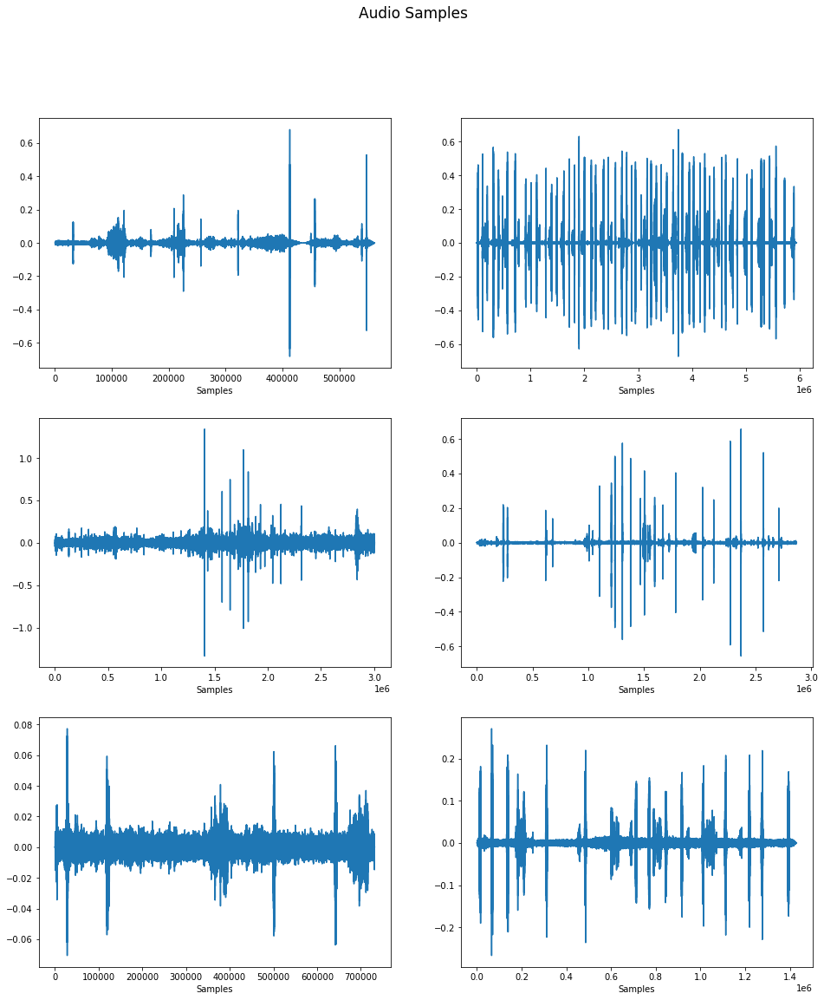

In [6]:
length_of_audio_samples = len(audio_samples)
fig, ax = plt.subplots(int(length_of_audio_samples/2),2, figsize = (16,length_of_audio_samples*3)) 
    
# Drawing plots of Audio samples
count = 0
for r in range(0,int(length_of_audio_samples/2)):
    for c in range(0,2):
        sample = audio_samples[count]
        ax[r,c].plot(sample)
        count += 1
        ax[r,c].set_xlabel("Samples")
        
fig.suptitle("Audio Samples", fontsize = 17)
plt.show()

In [7]:
# Data Preparation
PATH = "C:\\Users\\patel\\Desktop\\GAN Project\\train_audio\\*"
BIRD = "aldfly"
SR = 22050

def load_data_gan(path, bird, sr, length = 6):
    data = []

    for path in glob.glob(path + bird + "/*"):
        file, birdsound = librosa.core.load(path, sr=sr)
        
        # All files must be at the same length
        if len(file) > sr*length:
            data.append(file[:sr*length])
            
        else:
            continue

    return np.array(data)

def normalization(X):
    mean = X.mean(keepdims=True)
    std = X.std(keepdims=True)
    X = (X - mean) / std
    print("Data Normalized...")
    return X

def rescale(X, rangeMin=-1, rangeMax=+1):
    if len(X) == 0:
        print("Error: Array is empty.")
        return X
    maxi = X.max()
    mini = X.min()
    X = np.interp(X, (mini, maxi), (rangeMin, rangeMax))
    print("Data Rescaled...")
    return X

In [8]:
x_train = load_data_gan(PATH, BIRD, SR, 5)

In [9]:
# We normalize and rescale the data to make it more suitable for modeling
x_train = normalization(x_train)
x_train = rescale(x_train)

Data Normalized...
Data Rescaled...


In [10]:
IPython.display.display(ipd.Audio(data = x_train[50], rate = 22050))

In [11]:
# Code for generator 
def create_generator():
    
    generator = Sequential()
    generator.add(Dense(units = 512, input_dim = 100))
    generator.add(ReLU())
    
    generator.add(Dense(units = 512))
    generator.add(ReLU())
    
    generator.add(Dense(units = 1024))
    generator.add(ReLU())
    
    generator.add(Dense(units = 1024))
    generator.add(ReLU())
    
    generator.add(Dense(units = x_train.shape[1]))
    
    generator.compile(loss ="binary_crossentropy",
                     optimizer = Adam(lr = 0.0001, beta_1 = 0.5))
    
    return generator

g = create_generator()
g.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 512)               51712     
                                                                 
 re_lu (ReLU)                (None, 512)               0         
                                                                 
 dense_1 (Dense)             (None, 512)               262656    
                                                                 
 re_lu_1 (ReLU)              (None, 512)               0         
                                                                 
 dense_2 (Dense)             (None, 1024)              525312    
                                                                 
 re_lu_2 (ReLU)              (None, 1024)              0         
                                                                 
 dense_3 (Dense)             (None, 1024)              1

In [12]:
# Code for discriminator 
def create_discriminator():
    discriminator = Sequential()
    discriminator.add(Dense(units = 1024,input_dim = x_train.shape[1])) 
    discriminator.add(ReLU())
    discriminator.add(Dropout(0.4))
    
    discriminator.add(Dense(units = 512)) 
    discriminator.add(ReLU())
    discriminator.add(Dropout(0.4))
    
    discriminator.add(Dense(units = 256)) 
    discriminator.add(ReLU())
    
    discriminator.add(Dense(units = 1, activation = "sigmoid"))
    
    discriminator.compile(loss = "binary_crossentropy",
                         optimizer = Adam(lr = 0.0001, beta_1 = 0.5))
    return discriminator

d = create_discriminator()
d.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_5 (Dense)             (None, 1024)              112897024 
                                                                 
 re_lu_4 (ReLU)              (None, 1024)              0         
                                                                 
 dropout (Dropout)           (None, 1024)              0         
                                                                 
 dense_6 (Dense)             (None, 512)               524800    
                                                                 
 re_lu_5 (ReLU)              (None, 512)               0         
                                                                 
 dropout_1 (Dropout)         (None, 512)               0         
                                                                 
 dense_7 (Dense)             (None, 256)              

In [13]:
# Code for GAN
def create_gan(discriminator, generator):
    discriminator.trainable = False
    gan_input = Input(shape=(100,))
    x = generator(gan_input)
    gan_output = discriminator(x)
    gan = Model(inputs = gan_input, outputs = gan_output)
    gan.compile(loss = "binary_crossentropy", optimizer = "adam")
    return gan

gan = create_gan(d,g)
gan.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 100)]             0         
                                                                 
 sequential (Sequential)     (None, 110250)            114895530 
                                                                 
 sequential_1 (Sequential)   (None, 1)                 113553409 
                                                                 
Total params: 228,448,939
Trainable params: 114,895,530
Non-trainable params: 113,553,409
_________________________________________________________________


In [14]:
# We train our model from here
def show_gen_samples(epochs, samples = 3):
    samplePlot = []
    fig        = plt.figure(figsize = (1, samples))
    noise      = np.random.normal(0, 1, (samples,100))
    audios     = g.predict(noise)        
    for i, audio in enumerate(audios):
        IPython.display.display(ipd.Audio(data = audio, rate = SR))
        samplePlot.append(fig.add_subplot(1, samples, i+1))
        samplePlot[i].plot(audio.flatten(), '-', )
    plt.gcf().set_size_inches(25, 5)
    plt.subplots_adjust(wspace=0.3,hspace=0.3)
    fig.suptitle("{} Epochs Result".format(epochs), fontsize = 17)
    plt.show()

1/1 [==============================] - 0s 40ms/step
epochs:  0
Time since start: 0.0
1/1 [==============================] - 0s 70ms/step


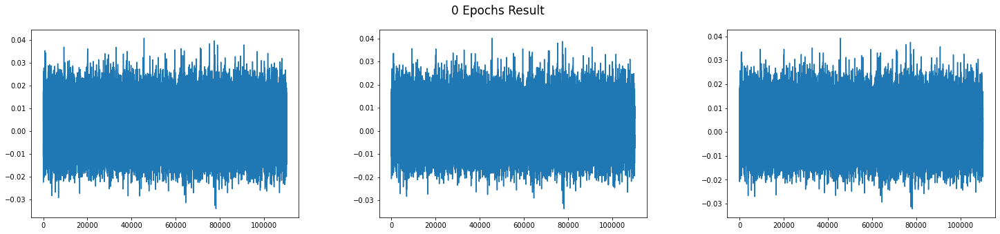

1/1 [==============================] - 0s 40ms/step
epochs:  2
1/1 [==============================] - 0s 40ms/step
epochs:  4
1/1 [==============================] - 0s 40ms/step
epochs:  6
1/1 [==============================] - 0s 40ms/step
epochs:  8
1/1 [==============================] - 0s 40ms/step
epochs:  10
Time since start: 271.0
1/1 [==============================] - 0s 40ms/step


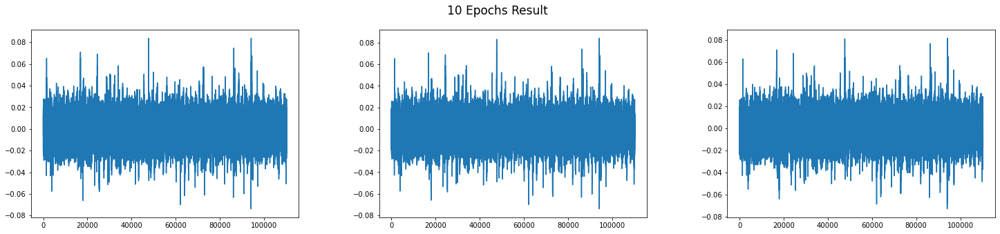

1/1 [==============================] - 0s 40ms/step
epochs:  12
1/1 [==============================] - 0s 40ms/step
epochs:  14
1/1 [==============================] - 0s 40ms/step
epochs:  16
1/1 [==============================] - 0s 35ms/step
epochs:  18
1/1 [==============================] - 0s 36ms/step
epochs:  20
Time since start: 542.0
1/1 [==============================] - 0s 40ms/step


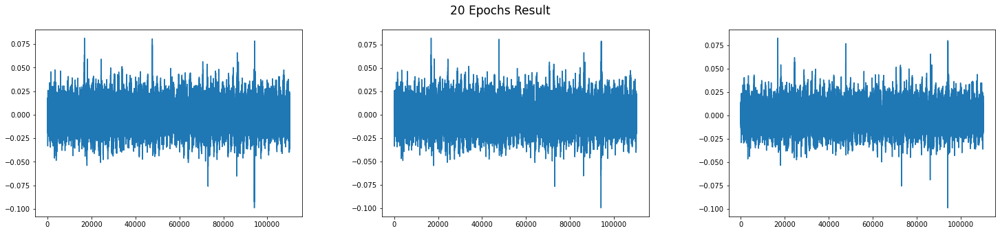

1/1 [==============================] - 0s 40ms/step
epochs:  22
1/1 [==============================] - 0s 40ms/step
epochs:  24
1/1 [==============================] - 0s 51ms/step
epochs:  26
1/1 [==============================] - 0s 40ms/step
epochs:  28
1/1 [==============================] - 0s 50ms/step
epochs:  30
Time since start: 812.0
1/1 [==============================] - 0s 44ms/step


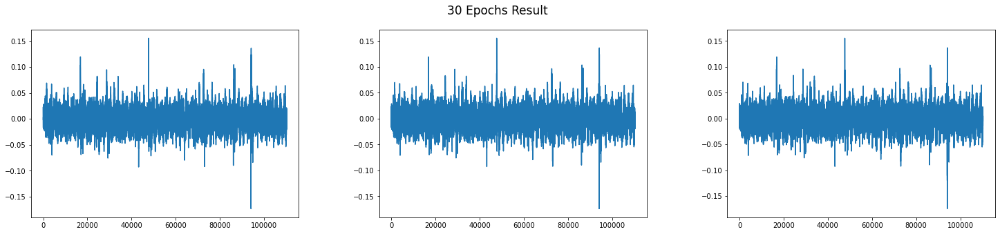

1/1 [==============================] - 0s 40ms/step
epochs:  32
1/1 [==============================] - 0s 40ms/step
epochs:  34
1/1 [==============================] - 0s 40ms/step
epochs:  36
1/1 [==============================] - 0s 40ms/step
epochs:  38
1/1 [==============================] - 0s 40ms/step
epochs:  40
Time since start: 1082.0
1/1 [==============================] - 0s 40ms/step


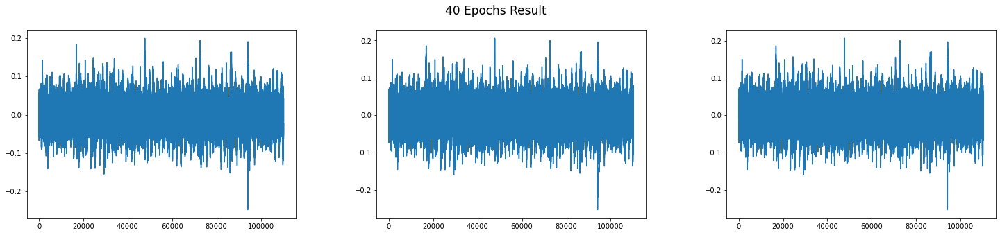

1/1 [==============================] - 0s 40ms/step
epochs:  42
1/1 [==============================] - 0s 37ms/step
epochs:  44
1/1 [==============================] - 0s 40ms/step
epochs:  46
1/1 [==============================] - 0s 40ms/step
epochs:  48
1/1 [==============================] - 0s 40ms/step
epochs:  49
Time since start: 1326.0
Training Complete.


In [15]:
import time

D_loss = []
G_loss = []
epochs = 50 
batch_size = 32
current_time = time.time()

for e in range(epochs):
    start_time = time.time()
    for _ in range(batch_size):
        
        noise = np.random.normal(0,1, [batch_size,100])
        
        generated_audio = g.predict(noise)
       
        audio_batch = x_train[np.random.randint(low = 0, high = x_train.shape[0], size = batch_size)] # Samples from real data
        
        x = np.concatenate([audio_batch, generated_audio])
        
        y_dis = np.zeros(batch_size*2) 
        y_dis[:batch_size] = 1 # Real audios are labeled as 1 and Generated audios are labeled 0
        
        d.trainable = True
        d_loss = d.train_on_batch(x,y_dis) # Training Discriminator
        
        noise = np.random.normal(0,1,[batch_size,100])
        
        y_gen = np.ones(batch_size) # our Generator says "these audios are real"
        
        d.trainable = False
        
        g_loss = gan.train_on_batch(noise, y_gen) 
        
        D_loss.append(d_loss)
        G_loss.append(g_loss)
        
    if (e%2 == 0) or (e == epochs-1) :
        print("epochs: ",e)
    if e == epochs-1:
        print("Time since start: {}".format(np.round(start_time - current_time)))
        print("Training Complete.")
    
    # Printing results after training
    if e%10 == 0:
        print("Time since start: {}".format(np.round(start_time - current_time)))
        show_gen_samples(e)

In [16]:
g.save("bird_sound_generator.h5")
d.save("bird_sound_discriminator.h5") 

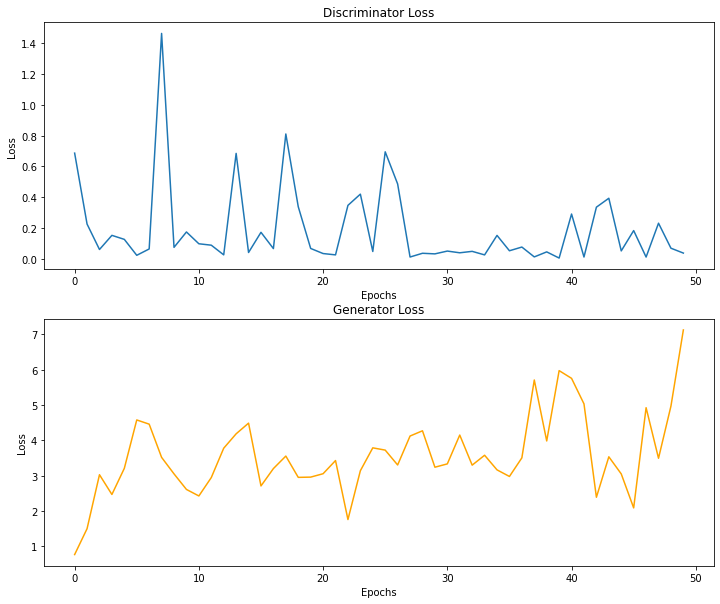

In [17]:
# Graphs for losses
index = 0
D_loss2 = []
G_loss2 = []

for i in range(1,epochs+1):
    D_loss2.append(D_loss[index])
    G_loss2.append(G_loss[index])
    index += batch_size

fig, axs = plt.subplots(2, 1, figsize = (12,10))

axs[0].plot(D_loss2, label = "Discriminator Loss")
axs[1].plot(G_loss2, label = "Generator Loss", color = "orange")

axs[0].set_xlabel("Epochs")
axs[1].set_xlabel("Epochs")

axs[0].set_ylabel("Loss")
axs[1].set_ylabel("Loss")

axs[0].set_title("Discriminator Loss")
axs[1].set_title("Generator Loss")
plt.show()

1/1 [==============================] - 0s 40ms/step


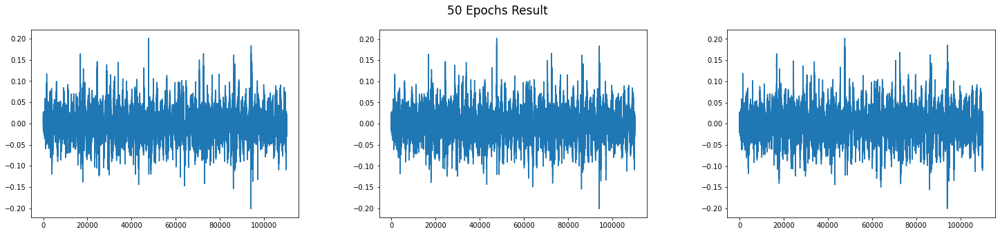

In [18]:
# Our computerized birds
show_gen_samples(epochs = epochs)